In [1]:
from lightning.pytorch.loggers import WandbLogger
import pathlib as pb
import sys
import os
os.chdir('..')

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
if (p := pb.Path(os.getcwd())) not in sys.path:
    sys.path.append(str(p))

from gic import *
from gic.data.dataset import GICDataset
from gic.data.dataloader import GICDataModule
from gic.learning.autoencoder.wrappers import DAEModule
from gic.learning.autoencoder.callbacks import ReconstructVizCallback

Seed set to 9128


In [4]:
loader = GICDataModule(DATA_PATH, 32)
model = DAEModule(64, 64).cuda()
model = model.train(False).requires_grad_(False)
model.load_state_dict(torch.load(CKPT_PATH / 'dae.pt'))

<All keys matched successfully>

In [5]:
data_train = GICDataset(DATA_PATH, 'train')
embeddings: t.List[torch.Tensor] = []

for i in range(len(data_train)):
    X, _ = data_train[i]
    l = model.autoencoder.encode(X.unsqueeze(0).to(DEVICE))
    embeddings.append(l.cpu())

train_embeddings = torch.cat(embeddings, dim=0).flatten(1)

In [6]:
data_valid = GICDataset(DATA_PATH, 'valid')
embeddings: t.List[torch.Tensor] = []

for i in range(len(data_valid)):
    X, _ = data_valid[i]
    l = model.autoencoder.encode(X.unsqueeze(0).to(DEVICE))
    embeddings.append(l.cpu())

valid_embeddings = torch.cat(embeddings, dim=0).flatten(1)

In [7]:
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score


# Fit using the DAE embeddings
cls = SVC(C=1.85)
cls.fit(train_embeddings.numpy(), data_train.data_['Class'].to_numpy())

# F1Score for Training Set
train_y_hat = cls.predict(train_embeddings.numpy())
train_score = f1_score(data_train.data_['Class'].to_numpy(), train_y_hat, average='macro')

# F1Score for Validation Set
valid_y_hat = cls.predict(valid_embeddings.numpy())
valid_score = f1_score(data_valid.data_['Class'].to_numpy(), valid_y_hat, average='macro')

# Show Scores
train_score, valid_score

(0.9505453583063534, 0.4756914240222816)

/home/invokariman/.cache/pypoetry/virtualenvs/gic-BfYgXNhZ-py3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


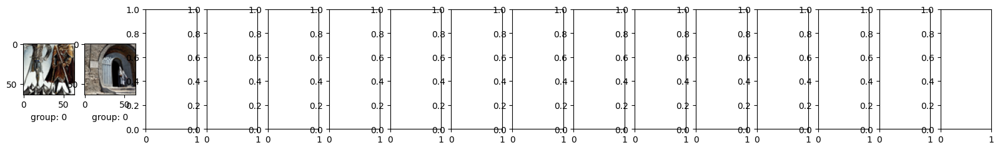

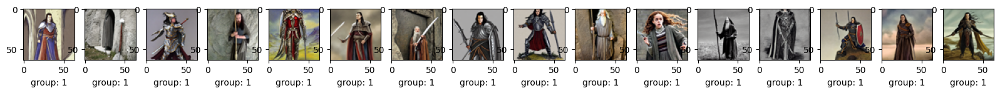

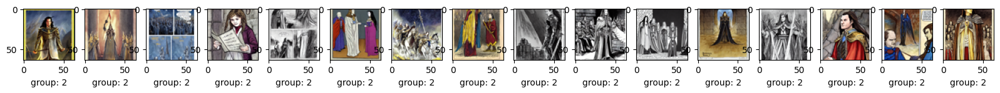

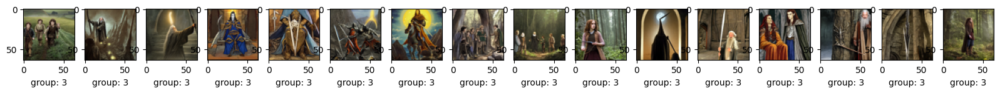

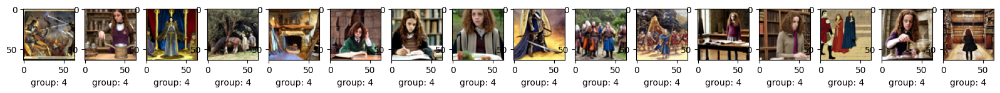

...

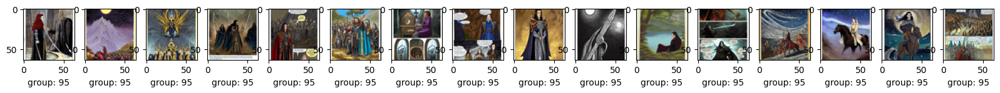

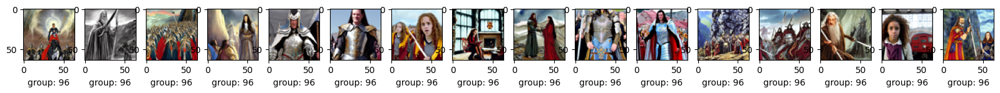

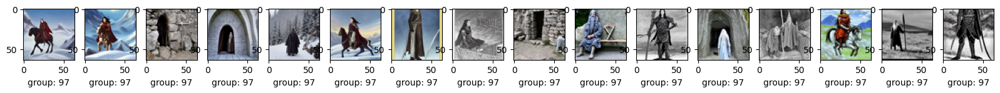

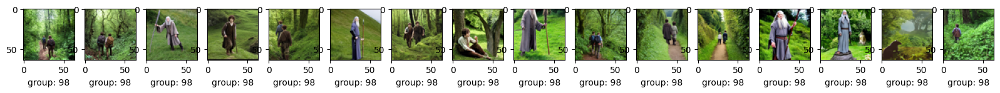

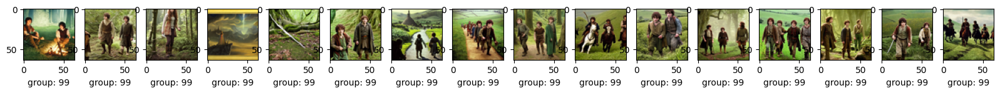

In [8]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as pt
from PIL import Image


# Cluster the Training Embeddings
kmeans = KMeans(n_clusters=100)
kmeans.fit(train_embeddings)

# Retain the ImagePaths for each image inside each cluster
groups = {}
for i, l in zip(range(len(data_train)), kmeans.labels_):
    data_train.data_.iloc[i]
    if l not in groups.keys():
        groups[l] = []
    groups[l].append(data_train.data_.iloc[i]['Image'])

# Display 16 images inside each cluster
for i, (g, imgs) in enumerate(sorted(groups.items(), key=lambda x: x[0])):
    f, ax = pt.subplots(1, 16, figsize=(20, 2.5))
    for j in range(min(16, len(imgs))):
        with Image.open(DATA_PATH / 'train_images' / imgs[j]) as img:
            ax[j].set_xlabel(f'group: {g}')
            ax[j].imshow(img)
    pt.show()